In [23]:
import cv2 as cv
import matplotlib.pyplot as plt

from matplotlib.patches import Rectangle

%matplotlib inline

### График обучения

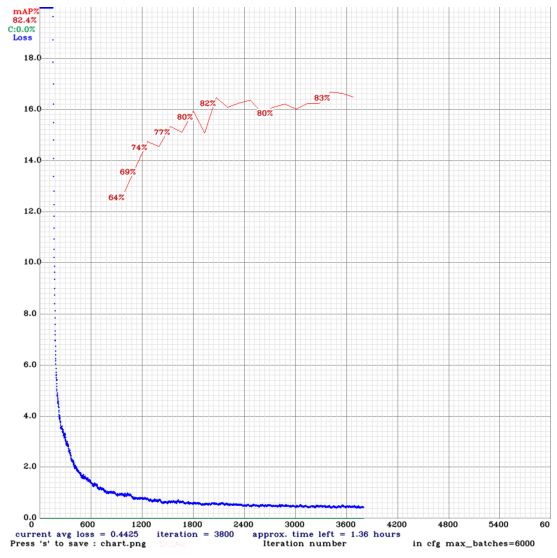

In [27]:
image = cv.imread(chart_path)

plt.figure(figsize=(20, 10))
plt.axis("off")
plt.imshow(cv.cvtColor(image, cv.COLOR_BGR2RGB))
plt.show()

### Визаулизация 20 изображений

In [20]:
def download_boxes(box_path):
    boxes = []
    with open(box_path, 'r') as fd:
        for box in fd.readlines():
            box = box[:-1]
            box = box.split(' ')
            box = [float(x) for x in box]
            box[0] = int(box[0])
            boxes.append(box)

    return boxes

In [21]:
def plot_boxes(
    boxes, ax, size=(1920, 1080), scores=None, threshold=None
    ):
    """
    Функция отрисовки bounding box-ов в yolo-формате.
    Аргументы:
      boxes -- массив боксов, которые задаются координатами
      class, center_x, center_y, width, height;
      classes -- метки классов
      scores -- уверенность модели в детекции боксов;
      threshold -- порог отсечения боксов по threshold;
      ax -- полотно, на котором отрображена исходная картинка.
    """
    
    box_kwargs = dict(linewidth=2, fill=False, facecolor='none')
    bbox = dict(facecolor='white', alpha=0.3)
    annot_kwargs = dict(color='black', size=10, bbox=bbox)
    
    edgecolor= ['red', 'green', 'blue']
    
    for i, box in enumerate(boxes):

        if (scores is not None) and (threshold is not None) and (scores[i] < threshold):
            continue

        label, center_x, center_y, width, height = box
        
        left_x = round((center_x - width / 2) * size[0])
        top_y = round((center_y - height / 2) * size[1])
        width = round(width * size[0])
        height = round(height * size[1])

        # Прямоугольная рамка
        box_patch = Rectangle((left_x, top_y), width=width, height=height, 
                              edgecolor=edgecolor[label], **box_kwargs)
        # Добавляем рамку к изображению
        ax.add_patch(box_patch)

        # Добавляем текст к фото справа сверху от рамки
        if scores is not None:
            ax.text(left_x, top_y, f"{label}, {scores[i]:.2f}", **annot_kwargs)
        else:
            ax.text(left_x, top_y, f"{label}", **annot_kwargs)

In [39]:
def visualize_result(orig_path, box_path, pred_path):
    orig_image = cv.imread(orig_path)
    pred_image = cv.imread(pred_path)
    orig_image = cv.cvtColor(orig_image, cv.COLOR_BGR2RGB)
    pred_image = cv.cvtColor(pred_image, cv.COLOR_BGR2RGB)

    boxes = download_boxes(box_path)

    height, width = pred_image.shape[:2]
    orig_image = cv.resize(orig_image,(width, height), interpolation = cv.INTER_CUBIC)
    pred_image = cv.resize(pred_image,(width, height), interpolation = cv.INTER_CUBIC)

    fig, axes = plt.subplots(1, 2, figsize=(30, 10))
    axes[0].axis("off")
    axes[0].imshow(orig_image)
    plot_boxes(boxes, axes[0])

    axes[1].axis("off")
    axes[1].imshow(pred_image)

    plt.show()

In [40]:
num_images = 20

In [41]:
def predict(orig_image_path):
    command = "python inference.py".split(' ')
    command.append(orig_image_path)
    
    import subprocess
    subprocess.run(command)

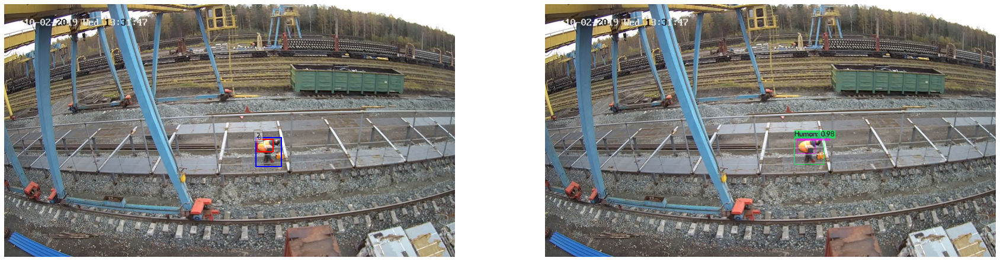

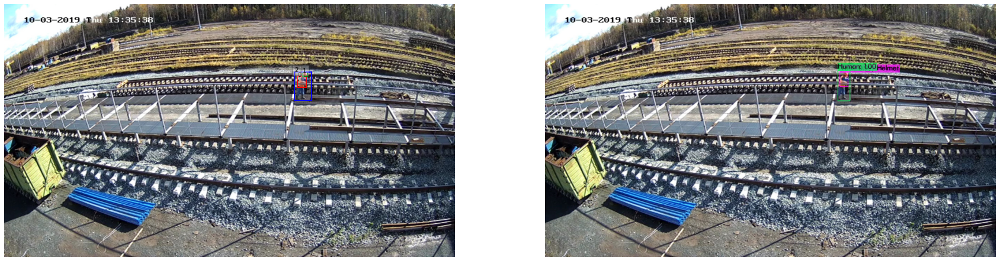

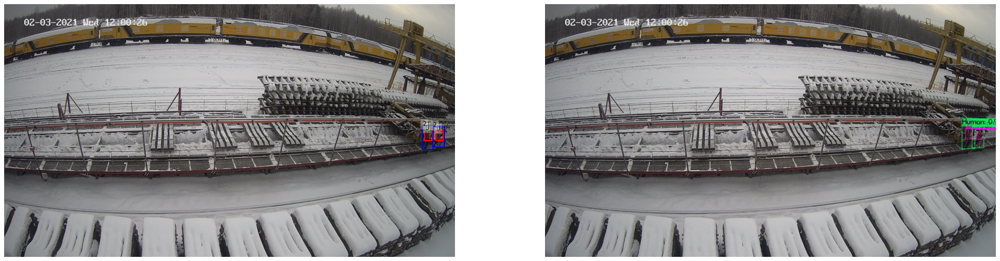

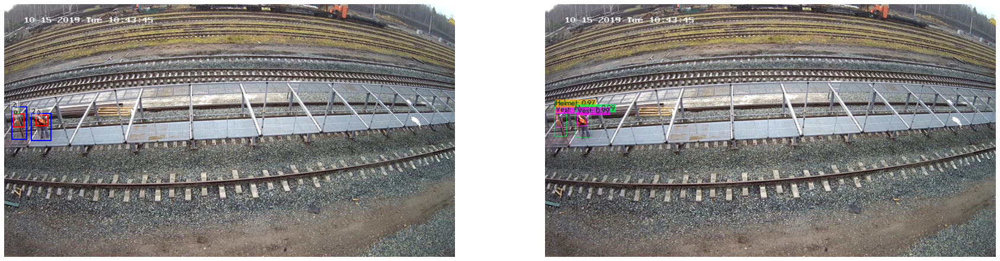

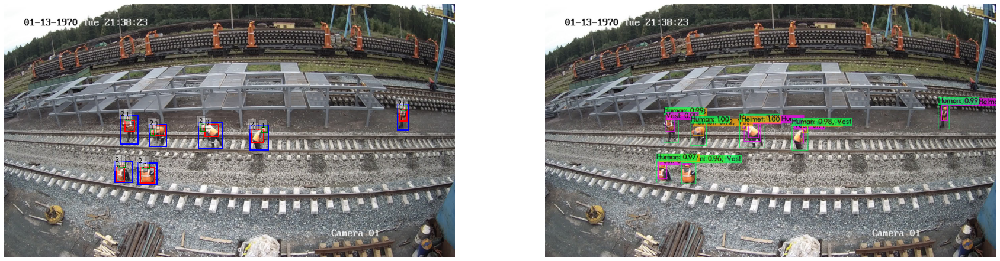

...

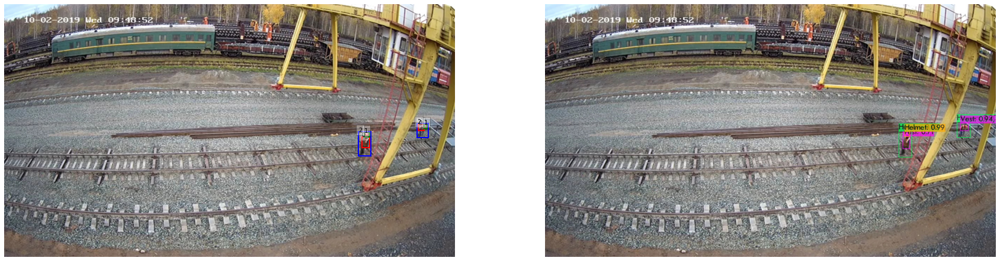

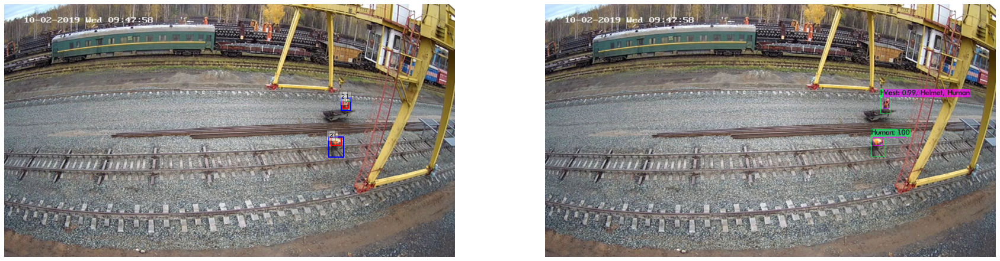

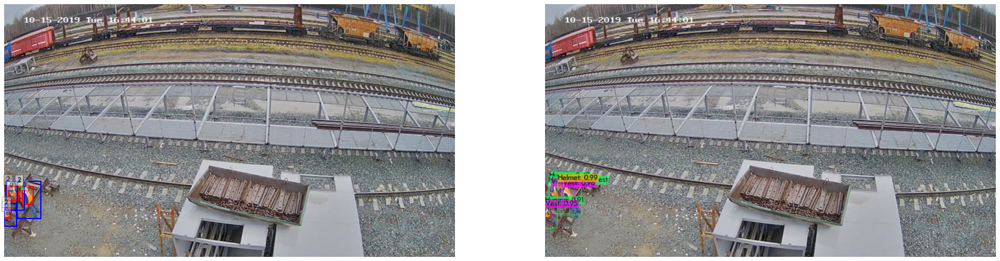

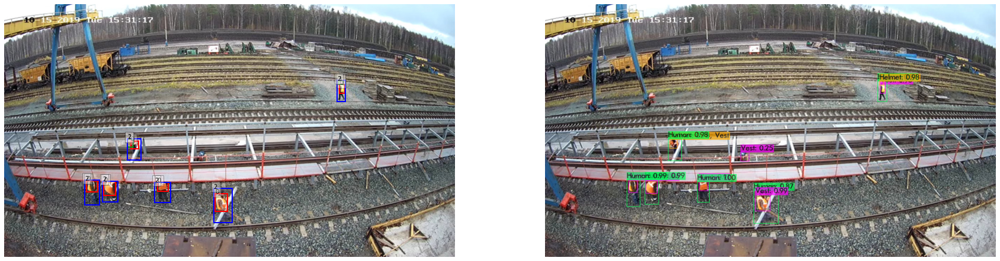

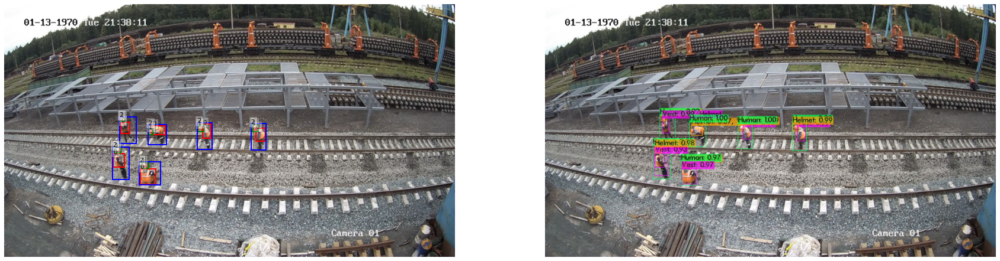

In [51]:
with open('data/test.txt', 'r') as fd:
    lines = fd.readlines()
    for i in range(num_images):
        orig_image_path = lines[i].replace('\n','')
        box_path = orig_image_path.replace('.jpg', '.txt')

        predict(orig_image_path)

        pred_image_path = './predictions.jpg'
        visualize_result(orig_image_path, box_path, pred_image_path)

Модель обучилась хорошо: на 20 тестовых изображений нет ложных срабатываний, все предсказания присутсвуют практически без ошибок. **mAP @ 0.50 = 83%** - метрика тоже удовлетворительная.

Модель можно улучшить несколими путями:
1. Использовать yolov4 обычную, не tiny.
2. Использовать аугментацию (HorizontalFlip, RandomBrightnessContrast, Crop для того, чтобы детектить частично обрезанные объекты).
3. Попробовать другие гиперпараметры.
4. Нарезать исходные изображения, а не сжимать их.